In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import random
import plotly.express as px
from loguru import logger
import geopy
import reverse_geocode
import pycountry_convert as pc
from metrics import get_metrics
mapbox_access_token = open(".mapbox_token").read()
px.set_mapbox_access_token(mapbox_access_token)

# Data Analysis

In [2]:
train_df = pd.read_csv("../data/train.csv")
val_df = pd.read_csv("../data/val.csv")
test_df = pd.read_csv("../data/test.csv")

train_df["split"] = "train"
val_df["split"] = "val"
test_df["split"] = "test"
all_data_df = pd.concat([train_df, val_df, test_df])
all_data_df["tss_value_log"] = np.log(all_data_df["tss_value"])
train_df.shape, val_df.shape, test_df.shape, all_data_df.shape

((18134, 88), (2488, 88), (2300, 88), (22922, 89))

In [3]:
old_data_df = pd.read_csv("../data/Aqusat_TSS_v1.csv")
old_data_df.shape

(32146, 477)

Label distribution: The new dataset has lower SSC values

In [4]:
tmp = np.exp(old_data_df["value"].values)
np.max(tmp), np.min(tmp)

(10900.000000000002, 0.11110999999999996)

In [5]:
tmp = all_data_df["tss_value"].values
np.max(tmp), np.min(tmp)

(723.0, 0.00335)

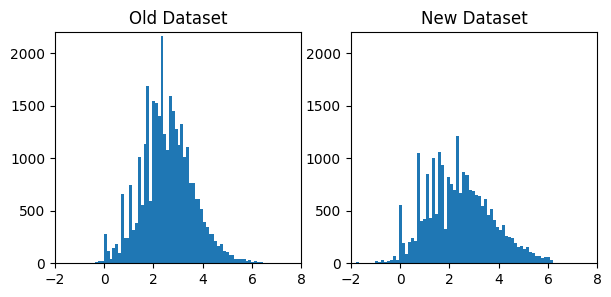

In [6]:
fig=plt.figure(figsize=(7,3))
n_rows,n_cols = 1,2

ax = fig.add_subplot(n_rows,n_cols,1)
ax.hist(old_data_df["value"].values, bins=100)
plt.title("Old Dataset")
plt.ylim(0, 2200)
plt.xlim(-2, 8)

ax = fig.add_subplot(n_rows,n_cols,2)
ax.hist(np.log(all_data_df["tss_value"].values), bins=100)
plt.title("New Dataset")
plt.ylim(0, 2200)
plt.xlim(-2, 8)
plt.show()

Geographic distribution: Old dataset was just in the US; new dataset has data points worldwide

In [7]:
# fig=px.scatter(all_data_df, x='lon', y='lat', #color="split", 
#     hover_data=["split", "date"], color="tss_value_log", title="[New data] SSC Values geographic distribution",
#     color_continuous_midpoint=0,)
# fig.update_yaxes(range=[-90,90])
# fig.update_xaxes(range=[-180,180])
# fig.show()

In [8]:

# df = px.data.carshare()
# fig = px.scatter_mapbox(df, lat="centroid_lat", lon="centroid_lon",     color="peak_hour", size="car_hours",
#                   color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, zoom=10)
fig = px.scatter_mapbox(all_data_df, lon='lon', lat='lat',    color="tss_value_log", #size="car_hours",
    color_continuous_scale=px.colors.cyclical.IceFire, 
    title="[New data] SSC Values geographic distribution",
    color_continuous_midpoint=0,
)
fig.update_layout(
    autosize=True,
    hovermode='closest',
    mapbox=dict(
        accesstoken=mapbox_access_token,
        bearing=0,
        center=dict(
            lat=38.92,
            lon=-77.07
        ),
        pitch=0,
        zoom=1
    ),
)
fig.show()

In [9]:
# NA: lat>10, lon<-50
# SA: lat < 10, lon<-50
# EU: lat, lon>50

NOTE: Other difference is old data is only for Landsat (New data is BOTH landsat and sentinel)

In [10]:
# fig=px.scatter(old_data_df, x='long', y='lat', 
#     color="value", title="[Old data] SSC Values geographic distribution",
#     color_continuous_midpoint=0,)
# fig.update_yaxes(range=[-90,90])
# fig.update_xaxes(range=[-180,180])
# fig.show()
fig = px.scatter_mapbox(old_data_df, lon='long', lat='lat',    color="value", #size="car_hours",
    color_continuous_scale=px.colors.cyclical.IceFire, 
    title="[Old data] SSC Values geographic distribution",
    color_continuous_midpoint=0,
)
fig.update_layout(
    autosize=True,
    hovermode='closest',
    mapbox=dict(
        accesstoken=mapbox_access_token,
        bearing=0,
        center=dict(
            lat=38.92,
            lon=-77.07
        ),
        pitch=0,
        zoom=1
    ),
)
fig.show()

<Axes: xlabel='date,date'>

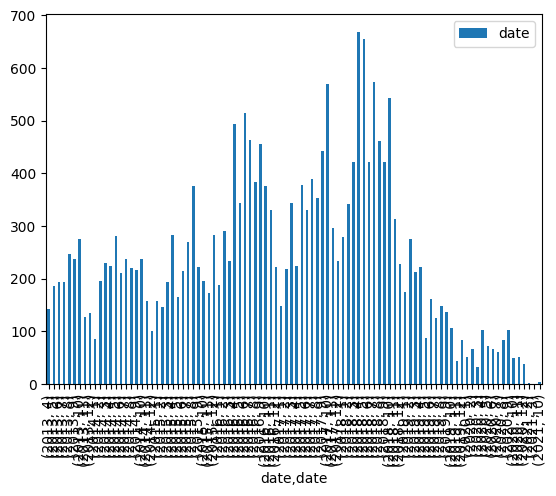

In [11]:

all_data_df["date"] = all_data_df["date"].astype("datetime64[ns]")
tmp = all_data_df[["date"]]
tmp.groupby([tmp["date"].dt.year, tmp["date"].dt.month]).count().plot(kind="bar")

<Axes: xlabel='date,date'>

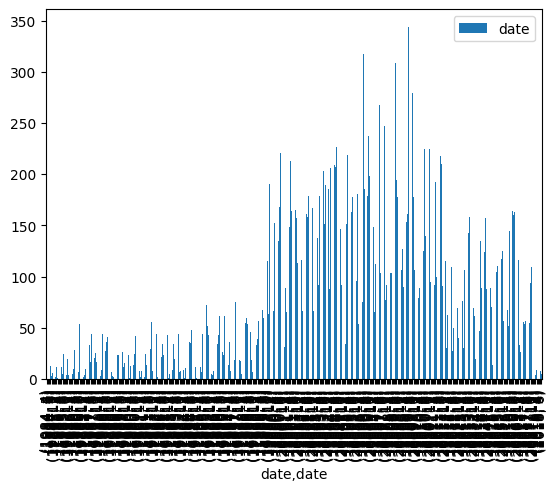

In [12]:
# old_data_df["date"].min(), old_data_df["date"].max()
old_data_df["date"] = old_data_df["date"].astype("datetime64[ns]")
tmp = old_data_df[["date"]]
tmp.groupby([tmp["date"].dt.year, tmp["date"].dt.month]).count().plot(kind="bar")


In [13]:
old_data_df["date"].min(), old_data_df["date"].max()    # 34 years

(Timestamp('1984-04-12 00:00:00'), Timestamp('2018-06-14 00:00:00'))

In [14]:
all_data_df["date"].min(), all_data_df["date"].max()    # 8 years

(Timestamp('2013-04-12 00:00:00'), Timestamp('2021-10-26 00:00:00'))

In [15]:
both_data = pd.DataFrame()
both_data["date"] = np.concatenate((all_data_df["date"].values, old_data_df["date"].values))
both_data["source"] = len(all_data_df["date"].values)*["new_data"] + len(old_data_df["date"].values)*["old_data"]
fig=px.scatter(both_data, x='source', y='date', color="source", hover_data=["source", "date"])
fig.show()

# Model Analysis

Error across geographic regions (maybe lat lon scatter plot, with color of point as error)

In [16]:
xgb_preds_df = pd.read_csv("../data/xgb_preds.csv")
xgb_preds_df.shape

(22780, 92)

In [17]:
xgb_preds_df.columns

Index(['SiteID', 'lat', 'lon', 'date', 'cloud_cover', 'tss_value',
       'relative_day', 'MGRS', 'LorS', 'b1_min', 'b1_mean', 'b1_max', 'b1_std',
       'b1_median', 'b1_count', 'b2_min', 'b2_mean', 'b2_max', 'b2_std',
       'b2_median', 'b2_count', 'b3_min', 'b3_mean', 'b3_max', 'b3_std',
       'b3_median', 'b3_count', 'b4_min', 'b4_mean', 'b4_max', 'b4_std',
       'b4_median', 'b4_count', 'b5_min', 'b5_mean', 'b5_max', 'b5_std',
       'b5_median', 'b5_count', 'b6_min', 'b6_mean', 'b6_max', 'b6_std',
       'b6_median', 'b6_count', 'b7_min', 'b7_mean', 'b7_max', 'b7_std',
       'b7_median', 'b7_count', 'b8_min', 'b8_mean', 'b8_max', 'b8_std',
       'b8_median', 'b8_count', 'b9_min', 'b9_mean', 'b9_max', 'b9_std',
       'b9_median', 'b9_count', 'b10_min', 'b10_mean', 'b10_max', 'b10_std',
       'b10_median', 'b10_count', 'b11_min', 'b11_mean', 'b11_max', 'b11_std',
       'b11_median', 'b11_count', 'b12_min', 'b12_mean', 'b12_max', 'b12_std',
       'b12_median', 'b12_count', 

In [18]:
print(xgb_preds_df["abs_error"].max(), xgb_preds_df["abs_error"].min())
print(xgb_preds_df["pred"].max(), xgb_preds_df["pred"].min())
print(xgb_preds_df["tss_value"].max(), xgb_preds_df["tss_value"].min())

676.1422767639161 2.8705596923916943e-05
357.29218 0.053891044
723.0 0.00335


In [19]:
lats=xgb_preds_df['lat'].to_list()
lons=xgb_preds_df['lon'].to_list()
coords = list(zip(lats, lons))
addresses = reverse_geocode.search(coords)

In [20]:
country_codes = []
cities = []
countries = []
for add in addresses:
    country_codes.append(add["country_code"])
    cities.append(add["city"])
    countries.append(add["country"])
xgb_preds_df["country_code"] = country_codes
xgb_preds_df["country"] = countries
xgb_preds_df["city"] = cities


def country_to_continent(country_name):
    country_alpha2 = pc.country_name_to_country_alpha2(country_name)
    if country_alpha2 == "VA":
        return "Europe"
    country_continent_code = pc.country_alpha2_to_continent_code(country_alpha2)
    country_continent_name = pc.convert_continent_code_to_continent_name(country_continent_code)
    return country_continent_name

continents = []
for c in countries:
    cont=""
    if c:
        cont = country_to_continent(c)
    continents.append(cont)
xgb_preds_df["continent"] = continents


/home/rdaroya_umass_edu/miniconda3/envs/ann-ssc/lib/python3.9/site-packages/pycountry/db.py:51: UserWarning:

Country's official_name not found. Country name provided instead.

/home/rdaroya_umass_edu/miniconda3/envs/ann-ssc/lib/python3.9/site-packages/pycountry/db.py:51: UserWarning:

Country's common_name not found. Country name provided instead.



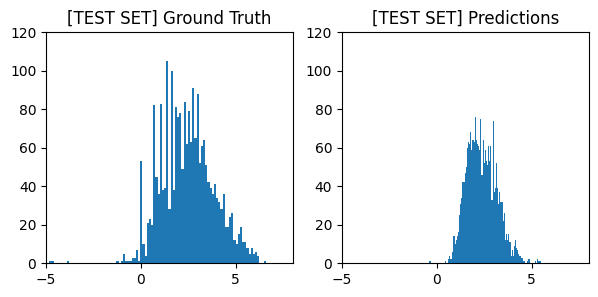

In [21]:
xgb_preds_sample = xgb_preds_df[xgb_preds_df["split"]=="test"]
fig=plt.figure(figsize=(7,3))
n_rows,n_cols = 1,2

ax = fig.add_subplot(n_rows,n_cols,1)
ax.hist(np.log(xgb_preds_sample["tss_value"].values), bins=100)
plt.title("[TEST SET] Ground Truth")
plt.ylim(0, 120)
plt.xlim(-5, 8)

ax = fig.add_subplot(n_rows,n_cols,2)
ax.hist(np.log(xgb_preds_sample["pred"].values), bins=100)
plt.title("[TEST SET] Predictions")
plt.ylim(0, 120)
plt.xlim(-5, 8)
plt.show()

In [50]:
# TODO: Make gif of increasing threshold to filter out high error areas
# xgb_preds_sample = xgb_preds_df[xgb_preds_df["abs_error"]>-1]
xgb_preds_sample = xgb_preds_df.copy()
xgb_preds_sample = xgb_preds_df[xgb_preds_df["split"]=="test"]
xgb_preds_sample["error"] = xgb_preds_sample["pred"]-xgb_preds_sample["tss_value"]

fig = px.scatter_mapbox(xgb_preds_sample, lon='lon', lat='lat', color="error",
    hover_data=["split", "tss_value", "pred", "tss_value_log", "pred_log", "date"],
    color_continuous_scale=px.colors.cyclical.IceFire, 
    title="[New data] Pred Error geographic distribution (model tends to underpredict)",
    color_continuous_midpoint=0,
)
fig.update_layout(
    autosize=True,
    hovermode='closest',
    mapbox=dict(
        accesstoken=mapbox_access_token,
        bearing=0,
        center=dict(
            lat=38.92,
            lon=-77.07
        ),
        pitch=0,
        zoom=1
    ),
)
fig.show()

/tmp/ipykernel_2493713/385433045.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [51]:
fig = px.scatter_mapbox(xgb_preds_df, lon='lon', lat='lat', color="split",
    hover_data=["split", "tss_value", "pred", "tss_value_log", "pred_log"],
    color_continuous_scale=px.colors.cyclical.IceFire, 
    title="[New data] Data Split geographic distribution",
    color_continuous_midpoint=0,
)
fig.update_layout(
    autosize=True,
    hovermode='closest',
    mapbox=dict(
        accesstoken=mapbox_access_token,
        bearing=0,
        center=dict(
            lat=38.92,
            lon=-77.07
        ),
        pitch=0,
        zoom=1
    ),
)
fig.show()

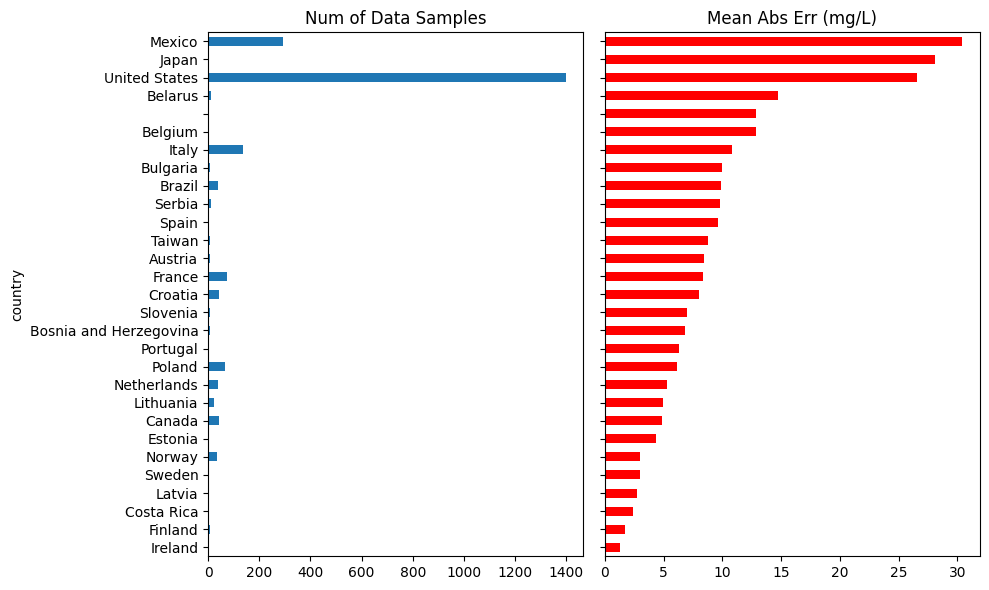

In [24]:

xgb_preds_sample = xgb_preds_df.copy()
xgb_preds_sample = xgb_preds_df[xgb_preds_df["split"]=="test"]
dfg = xgb_preds_sample.groupby(['country'])["abs_error"].agg(['mean','count'])
dfg = dfg.reset_index()
dfg = dfg.sort_values(by=["mean"])
numplot = 2
fig, axes = plt.subplots(1, numplot, sharey=True, sharex=False, figsize=(10, 6))
# for (t, prices), ax in zip(dfg, axes):
dfg.plot.barh(x="country", y="count",legend=False, ax=axes[0])
axes[0].set_title("Num of Data Samples")
# axes[0].set_xlim([0,1000])
dfg.plot.barh(x="country", y="mean",legend=False, ax=axes[1], color="red")
axes[1].set_title("Mean Abs Err (mg/L)")
# axes[1].set_xlim([0,100])
fig.tight_layout()
plt.show()

In [25]:

# xgb_preds_sample = xgb_preds_df.copy()
# xgb_preds_sample = xgb_preds_df[((xgb_preds_df["split"]=="test")&(xgb_preds_df["country"]=="United States"))]
# dfg = xgb_preds_sample.groupby(['city'])["abs_error"].agg(['mean','count'])
# dfg = dfg.reset_index()
# dfg = dfg.sort_values(by=["mean"])
# numplot = 2
# fig, axes = plt.subplots(1, numplot, sharey=True, sharex=False, figsize=(10, 50))
# # for (t, prices), ax in zip(dfg, axes):
# dfg.plot.barh(x="city", y="count",legend=False, ax=axes[0])
# axes[0].set_title("Num of Data Samples")
# # axes[0].set_xlim([0,1000])
# dfg.plot.barh(x="city", y="mean",legend=False, ax=axes[1], color="red")
# axes[1].set_title("Mean Abs Err (mg/L)")
# # axes[1].set_xlim([0,100])
# fig.tight_layout()
# plt.show()

In [26]:

# test_set_preds = xgb_preds_df[((xgb_preds_df["split"]=="test")&(~xgb_preds_df["country"].isin(["Mexico", "United States"])))]
# test_set_preds = xgb_preds_df[((xgb_preds_df["split"]=="test")&(xgb_preds_df["continent"].isin(["North America"])))]

test_set_preds = xgb_preds_df[((xgb_preds_df["split"]=="test"))]
test_pred, test_gt = test_set_preds["pred"].values, test_set_preds["tss_value"].values
test_metrics = get_metrics(test_gt, test_pred)
test_metrics

{'rmse': 55.165922444225345,
 'mae': 22.200770841672533,
 'mape': 2.787343046958883,
 'r2': 0.14257967687055462,
 'bias': 16.012467881108403,
 'pct_bias': -2.274091497228557,
 'smape': 0.7110897159404426}

In [27]:
test_set_preds["continent"].value_counts()

continent
North America    1732
Europe            502
South America      37
Asia               14
                    2
Name: count, dtype: int64

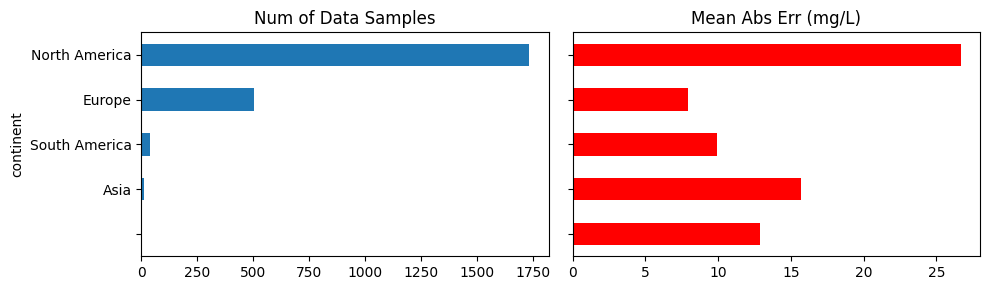

In [28]:

xgb_preds_sample = xgb_preds_df.copy()
xgb_preds_sample = xgb_preds_df[xgb_preds_df["split"]=="test"]
dfg = xgb_preds_sample.groupby(['continent'])["abs_error"].agg(['mean','count'])
dfg = dfg.reset_index()
dfg = dfg.sort_values(by=["count"])
numplot = 2
fig, axes = plt.subplots(1, numplot, sharey=True, sharex=False, figsize=(10, 3))
# for (t, prices), ax in zip(dfg, axes):
dfg.plot.barh(x="continent", y="count",legend=False, ax=axes[0])
axes[0].set_title("Num of Data Samples")
# axes[0].set_xlim([0,1000])
dfg.plot.barh(x="continent", y="mean",legend=False, ax=axes[1], color="red")
axes[1].set_title("Mean Abs Err (mg/L)")
# axes[1].set_xlim([0,100])
fig.tight_layout()
plt.show()

Scatter plot of SSC values per continent, colored with MAE per data point

In [29]:
fig=px.scatter(
    xgb_preds_df, x='continent', y='tss_value', color="abs_error", 
    hover_data=["continent", "country", "city", "tss_value", "pred", "abs_error", "lat", "lon"]
)
fig.show()

In [30]:
fig=px.scatter(
    xgb_preds_df, x='continent', y='abs_error', color="tss_value", 
    hover_data=["continent", "country", "city", "tss_value", "pred", "abs_error", "lat", "lon"],
    title="Higher Abs Err Corresponds to Higher Ground Truth TSS Value",
)
fig.show()

Text(0.5, 1.0, 'XGB Abs Error Histogram (mg/L)')

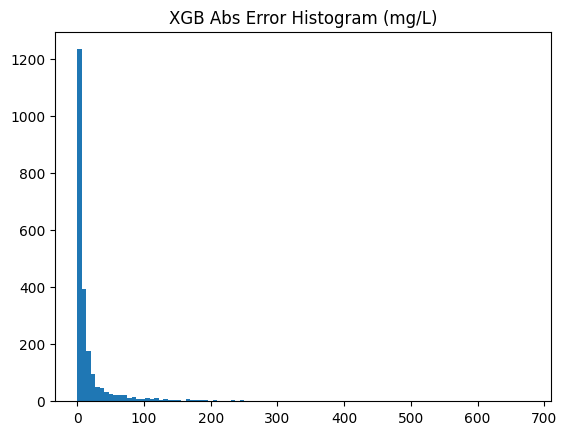

In [31]:
xgb_preds_sample = xgb_preds_df[xgb_preds_df["split"]=="test"]
plt.hist((xgb_preds_sample["abs_error"].values), bins=100)
plt.title("XGB Abs Error Histogram (mg/L)")
# plt.ylim(0, 2200)
# plt.xlim(-2, 8)

Error between Landsat and Sentinel

In [32]:
xgb_preds_df.columns

Index(['SiteID', 'lat', 'lon', 'date', 'cloud_cover', 'tss_value',
       'relative_day', 'MGRS', 'LorS', 'b1_min', 'b1_mean', 'b1_max', 'b1_std',
       'b1_median', 'b1_count', 'b2_min', 'b2_mean', 'b2_max', 'b2_std',
       'b2_median', 'b2_count', 'b3_min', 'b3_mean', 'b3_max', 'b3_std',
       'b3_median', 'b3_count', 'b4_min', 'b4_mean', 'b4_max', 'b4_std',
       'b4_median', 'b4_count', 'b5_min', 'b5_mean', 'b5_max', 'b5_std',
       'b5_median', 'b5_count', 'b6_min', 'b6_mean', 'b6_max', 'b6_std',
       'b6_median', 'b6_count', 'b7_min', 'b7_mean', 'b7_max', 'b7_std',
       'b7_median', 'b7_count', 'b8_min', 'b8_mean', 'b8_max', 'b8_std',
       'b8_median', 'b8_count', 'b9_min', 'b9_mean', 'b9_max', 'b9_std',
       'b9_median', 'b9_count', 'b10_min', 'b10_mean', 'b10_max', 'b10_std',
       'b10_median', 'b10_count', 'b11_min', 'b11_mean', 'b11_max', 'b11_std',
       'b11_median', 'b11_count', 'b12_min', 'b12_mean', 'b12_max', 'b12_std',
       'b12_median', 'b12_count', 

In [33]:
fig=px.scatter(
    xgb_preds_df, x='LorS', y='abs_error', color="tss_value", 
    hover_data=["LorS", "continent", "country", "city", "tss_value", "pred", "abs_error", "lat", "lon"],
    title="Higher Abs Err for Sentinel data",

)
fig.show()

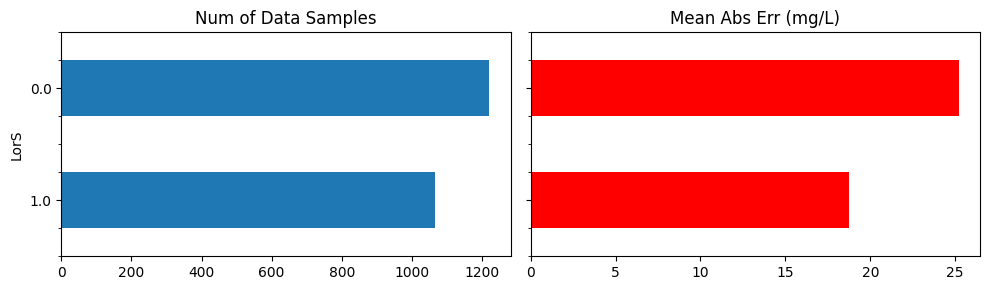

In [34]:

xgb_preds_sample = xgb_preds_df.copy()
xgb_preds_sample = xgb_preds_df[xgb_preds_df["split"]=="test"]
dfg = xgb_preds_sample.groupby(['LorS'])["abs_error"].agg(['mean','count'])
dfg = dfg.reset_index()
dfg = dfg.sort_values(by=["count"])
numplot = 2
fig, axes = plt.subplots(1, numplot, sharey=True, sharex=False, figsize=(10, 3))
# for (t, prices), ax in zip(dfg, axes):
dfg.plot.barh(x="LorS", y="count",legend=False, ax=axes[0])
axes[0].set_title("Num of Data Samples")
# axes[0].set_xlim([0,1000])
dfg.plot.barh(x="LorS", y="mean",legend=False, ax=axes[1], color="red")
axes[1].set_title("Mean Abs Err (mg/L)")
# axes[1].set_xlim([0,100])
fig.tight_layout()
plt.show()

Could time have an effect? (i.e., seasons)

In [40]:
xgb_preds_df.columns

Index(['SiteID', 'lat', 'lon', 'date', 'cloud_cover', 'tss_value',
       'relative_day', 'MGRS', 'LorS', 'b1_min', 'b1_mean', 'b1_max', 'b1_std',
       'b1_median', 'b1_count', 'b2_min', 'b2_mean', 'b2_max', 'b2_std',
       'b2_median', 'b2_count', 'b3_min', 'b3_mean', 'b3_max', 'b3_std',
       'b3_median', 'b3_count', 'b4_min', 'b4_mean', 'b4_max', 'b4_std',
       'b4_median', 'b4_count', 'b5_min', 'b5_mean', 'b5_max', 'b5_std',
       'b5_median', 'b5_count', 'b6_min', 'b6_mean', 'b6_max', 'b6_std',
       'b6_median', 'b6_count', 'b7_min', 'b7_mean', 'b7_max', 'b7_std',
       'b7_median', 'b7_count', 'b8_min', 'b8_mean', 'b8_max', 'b8_std',
       'b8_median', 'b8_count', 'b9_min', 'b9_mean', 'b9_max', 'b9_std',
       'b9_median', 'b9_count', 'b10_min', 'b10_mean', 'b10_max', 'b10_std',
       'b10_median', 'b10_count', 'b11_min', 'b11_mean', 'b11_max', 'b11_std',
       'b11_median', 'b11_count', 'b12_min', 'b12_mean', 'b12_max', 'b12_std',
       'b12_median', 'b12_count', 

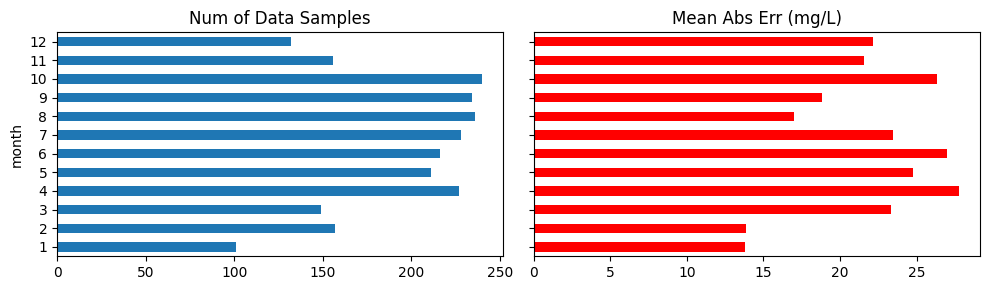

In [44]:
# TODO: Add seasons (only for US, etc where there is winter or something)
xgb_preds_df["date"] = xgb_preds_df["date"].astype("datetime64[ns]")
xgb_preds_df["month"] = xgb_preds_df["date"].dt.month



xgb_preds_sample = xgb_preds_df.copy()
xgb_preds_sample = xgb_preds_df[xgb_preds_df["split"]=="test"]
dfg = xgb_preds_sample.groupby(['month'])["abs_error"].agg(['mean','count'])
dfg = dfg.reset_index()
dfg = dfg.sort_values(by=["month"])
numplot = 2
fig, axes = plt.subplots(1, numplot, sharey=True, sharex=False, figsize=(10, 3))
# for (t, prices), ax in zip(dfg, axes):
dfg.plot.barh(x="month", y="count",legend=False, ax=axes[0])
axes[0].set_title("Num of Data Samples")
# axes[0].set_xlim([0,1000])
dfg.plot.barh(x="month", y="mean",legend=False, ax=axes[1], color="red")
axes[1].set_title("Mean Abs Err (mg/L)")
# axes[1].set_xlim([0,100])
fig.tight_layout()
plt.show()


In [49]:

xgb_preds_sample = xgb_preds_df.copy()
xgb_preds_sample = xgb_preds_df[xgb_preds_df["split"]=="test"]
fig=px.scatter(        
    xgb_preds_sample, x='abs_error', y='month', color="tss_value", 
    hover_data=["LorS", "continent", "country", "city", "tss_value", "pred", "abs_error", "lat", "lon", "cloud_cover"],
)
fig.show()

In [ ]:
# High Cloud cover vs SSC prediction?

Could the elevation have an effect in the ssc estimation?

### Key Insights
* Most of the error comes from North America
* The model tends to underpredict (rather than overpredict) SSC values
* Predictions on Sentinel have a higher mean abs error